In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load in 

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# Any results you write to the current directory are saved as output.

/kaggle/input/covid19-global-forecasting-week-1/train.csv
/kaggle/input/covid19-global-forecasting-week-1/submission.csv
/kaggle/input/covid19-global-forecasting-week-1/test.csv


In [2]:
import seaborn as sns
from sklearn import linear_model
from sklearn.tree import DecisionTreeRegressor as DTR
from sklearn.ensemble import RandomForestRegressor
import matplotlib.pyplot as plt

In [3]:
train_df = pd.read_csv("/kaggle/input/covid19-global-forecasting-week-1/train.csv")
test_df = pd.read_csv("/kaggle/input/covid19-global-forecasting-week-1/test.csv")

In [4]:
train_df.describe()

,Id,Lat,Long,ConfirmedCases,Fatalities
count,17892.000000,17892.000000,17892.000000,17892.000000,17892.000000
mean,13191.500000,26.287693,4.766191,325.207523,11.974737
std,7624.675152,22.935092,79.923261,3538.599684,174.346267
min,1.000000,-41.454500,-157.498300,0.000000,0.000000
25%,6596.250000,13.145425,-71.516375,0.000000,0.000000
50%,13191.500000,32.985550,9.775000,0.000000,0.000000
75%,19786.750000,42.501575,64.688975,10.000000,0.000000
max,26382.000000,71.706900,174.886000,69176.000000,6820.000000


From the describe of dataset it is clear that Province/State is column is NaN. Hence, we delete that column

In [5]:
# Dropping NaN
train_df.drop(['Province/State'], axis=1, inplace=True)
test_df.drop(['Province/State'], axis=1, inplace=True)

In [6]:
# Duplicating the data for model fitting
temp_train_df = train_df.copy()
temp_test_df = test_df.copy()

In [7]:
train_df.head()

,Id,Country/Region,Lat,Long,Date,ConfirmedCases,Fatalities
0,1,Afghanistan,33.0,65.0,2020-01-22,0.0,0.0
1,2,Afghanistan,33.0,65.0,2020-01-23,0.0,0.0
2,3,Afghanistan,33.0,65.0,2020-01-24,0.0,0.0
3,4,Afghanistan,33.0,65.0,2020-01-25,0.0,0.0
4,5,Afghanistan,33.0,65.0,2020-01-26,0.0,0.0


In [8]:
# Finding Unique Countries for better interpretation and plotting
Unique_countries = list(train_df['Country/Region'].unique())
group_by_country = train_df.groupby(['Country/Region'])

Finding how many countries are affected by COVID-19

In [9]:
print("No of countries affected by COVID-19 =",len(Unique_countries))

No of countries affected by COVID-19 = 163


Finding Top 10 countries which has maximum no of COVID-19 cases along with no of death cases and death rate

In [10]:
# Finding country-wise confirmed cases and death cases
Count = []
Country = []
Death = []

for country in Unique_countries:
    Country.append(country)
    Count.append(int(group_by_country.get_group(country).ConfirmedCases.sum()))
    Death.append(group_by_country.get_group(country).Fatalities.sum())

In [11]:
Confirmed_Cases_df = pd.DataFrame()

Confirmed_Cases_df['Country'] = Country
Confirmed_Cases_df['Confirmed_Cases'] = Count
Confirmed_Cases_df['Death'] = Death
Confirmed_Cases_df['Death_rate'] = Confirmed_Cases_df['Death'] / Confirmed_Cases_df['Confirmed_Cases']

In [12]:
Confirmed_Cases_df.head()

,Country,Confirmed_Cases,Death,Death_rate
0,Afghanistan,363,3.0,0.008264
1,Albania,851,26.0,0.030552
2,Algeria,1485,113.0,0.076094
3,Andorra,720,3.0,0.004167
4,Antigua and Barbuda,16,0.0,0.000000


In [13]:
print("Top 10 countries affected by COVID-19")
print(Confirmed_Cases_df.sort_values(by = 'Confirmed_Cases', ascending=False)[['Country','Confirmed_Cases']].head(10))

Top 10 countries affected by COVID-19
            Country  Confirmed_Cases
29            China          3500461
75            Italy           571924
71             Iran           278992
139           Spain           232453
154              US           219412
55          Germany           198143
82     Korea, South           190800
50           France           122701
144     Switzerland            57840
157  United Kingdom            44451


In [14]:
print("Top 10 countries which has max no of death")
print(Confirmed_Cases_df.sort_values(by = 'Death', ascending=False)[['Country','Death']].head(10))

Top 10 countries which has max no of death
            Country     Death
29            China  121046.0
75            Italy   46856.0
71             Iran   16870.0
139           Spain   12464.0
50           France    3721.0
154              US    2972.0
157  United Kingdom    1859.0
82     Korea, South    1670.0
107     Netherlands    1181.0
55          Germany     675.0


In [15]:
print("Top 10 countries which has highest Death rate")
print(Confirmed_Cases_df.sort_values(by = 'Death_rate', ascending=False)[['Country','Death_rate']].head(10))

Top 10 countries which has highest Death rate
         Country  Death_rate
141        Sudan    0.600000
52         Gabon    0.172414
64        Guyana    0.166667
129   San Marino    0.084388
75         Italy    0.081927
72          Iraq    0.079829
61     Guatemala    0.078947
117  Philippines    0.078077
2        Algeria    0.076094
70     Indonesia    0.075648


Converting date into its respective months for plotting purpose

In [16]:
month_df = pd.DataFrame()
month_df["Date"] = train_df["Date"].apply(lambda x: x.split('-')[1])
month_df["Date"]  = month_df["Date"].astype(int)

In [17]:
def NumToMonth(x):
    if x == 1:
        return 'Jan'
    if x == 2:
        return 'Feb'
    if x == 3:
        return 'Mar'

In [18]:
month_df['Date'] = month_df['Date'].apply(lambda x: NumToMonth(x))

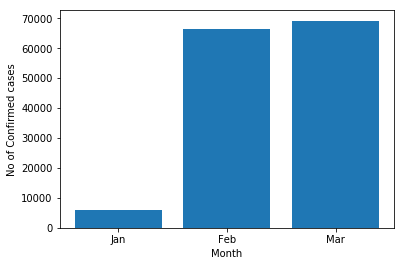

In [19]:
plt.bar(month_df['Date'],train_df['ConfirmedCases'])
plt.xlabel('Month')
plt.ylabel('No of Confirmed cases')
plt.show()

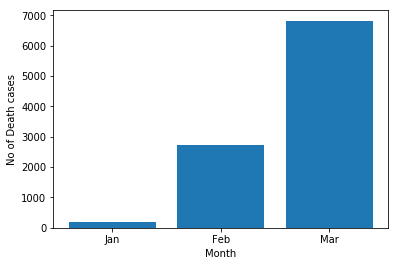

In [20]:
plt.bar(month_df['Date'],train_df['Fatalities'])
plt.xlabel('Month')
plt.ylabel('No of Death cases')
plt.show()

In [21]:
date_df = pd.DataFrame()
date_df['Date'] = train_df["Date"].apply(lambda x: x.replace("-",""))

In [22]:
Confirmed_Country = Confirmed_Cases_df.sort_values(by = 'Confirmed_Cases', ascending=False)[['Country']].head(10)

Plotting the confirmed cases country-wise

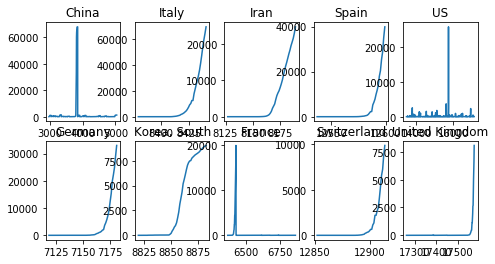

In [23]:
fig,axes= plt.subplots(nrows=2, ncols=5)
plt.subplots_adjust(left=4, right=5)
plt.rcParams.update({'figure.figsize':(9,7), 'figure.dpi':120})

for country in range(Confirmed_Country.shape[0]):
    temp = pd.DataFrame()
    temp['ConfirmedCases'] = group_by_country.get_group(Confirmed_Country.iloc[country,0])['ConfirmedCases']
    if country < 5:
        axes[0][country].plot(temp['ConfirmedCases'])
        axes[0][country].set_title(Confirmed_Country.iloc[country,0])
    else:
        axes[1][country-5].plot(temp['ConfirmedCases'])
        axes[1][country-5].set_title(Confirmed_Country.iloc[country,0])
plt.show()

Plotting Death cases country-wise

In [24]:
Death_Country = Confirmed_Cases_df.sort_values(by = 'Death', ascending=False)[['Country','Death']].head(10)

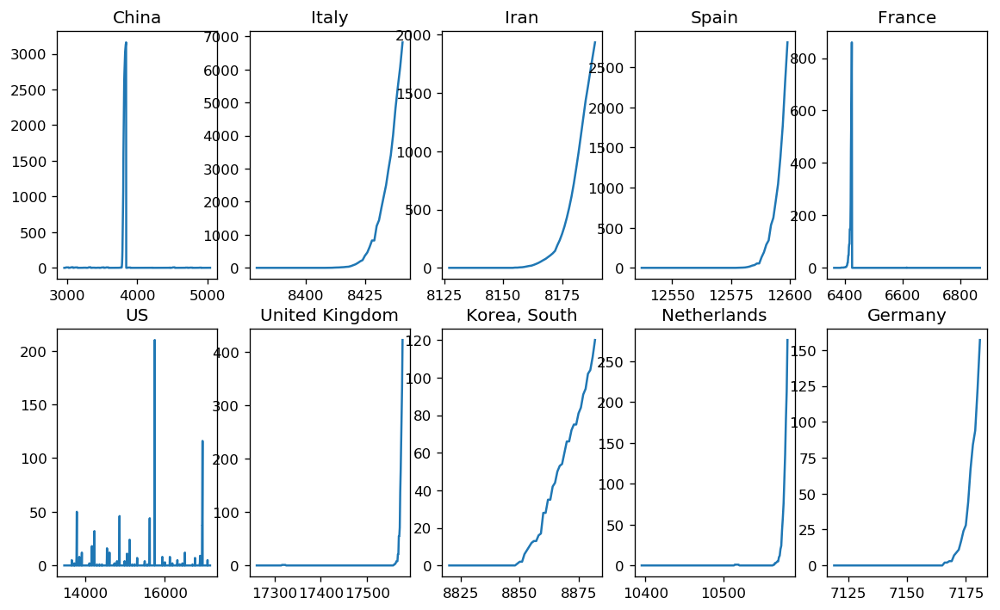

In [25]:
fig,axes= plt.subplots(nrows=2, ncols=5)
plt.subplots_adjust(left=4, right=5)
plt.rcParams.update({'figure.figsize':(9,7), 'figure.dpi':120})

for country in range(Death_Country.shape[0]):
    temp = pd.DataFrame()
    temp['Death'] = group_by_country.get_group(Death_Country.iloc[country,0])['Fatalities']
    if country < 5:
        axes[0][country].plot(temp['Death'])
        axes[0][country].set_title(Death_Country.iloc[country,0])
    else:
        axes[1][country-5].plot(temp['Death'])
        axes[1][country-5].set_title(Death_Country.iloc[country,0])
plt.show()

Plotting date-wise how CORONA has spread

[Text(0, 0.5, 'Total cases'), Text(0.5, 0, 'Dates')]

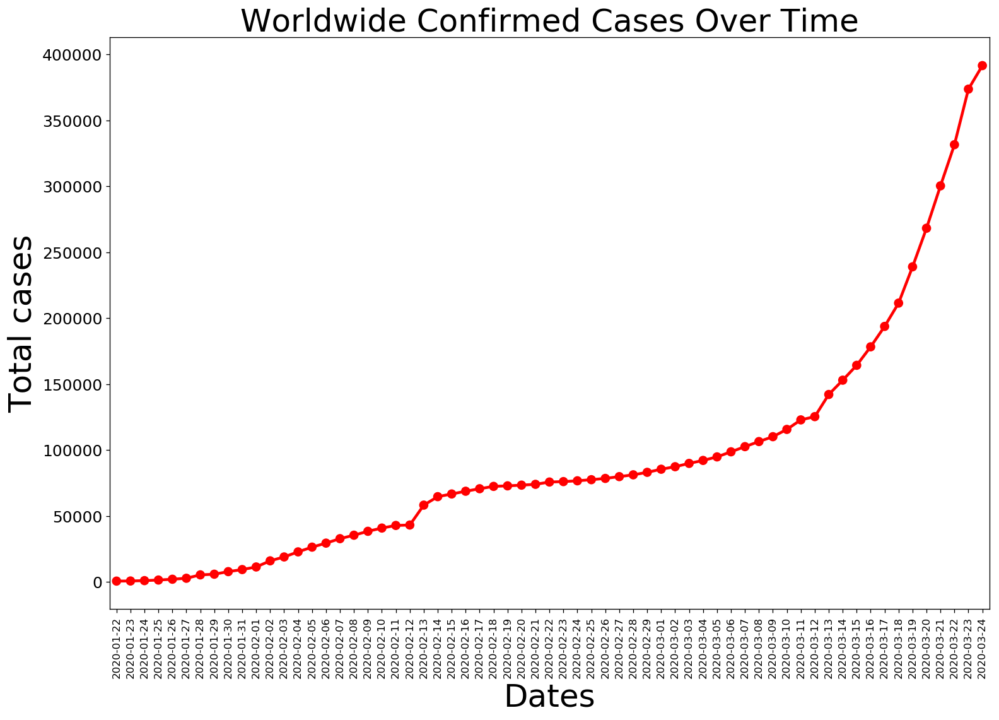

In [26]:
plt.figure(figsize= (15,10))
plt.xticks(rotation = 90 ,fontsize = 10)
plt.yticks(fontsize = 15)
plt.xlabel("Dates",fontsize = 30)
plt.ylabel('Total cases',fontsize = 30)
plt.title("Worldwide Confirmed Cases Over Time" , fontsize = 30)
total_cases = train_df.groupby('Date')['Date', 'ConfirmedCases'].sum().reset_index()
total_cases['date'] = pd.to_datetime(total_cases['Date'])


ax = sns.pointplot( x = total_cases.date.dt.date ,y = total_cases.ConfirmedCases , color = 'r')
ax.set(xlabel='Dates', ylabel='Total cases')

Plotting no of death cases date-wise

[Text(0, 0.5, 'Total cases'), Text(0.5, 0, 'Dates')]

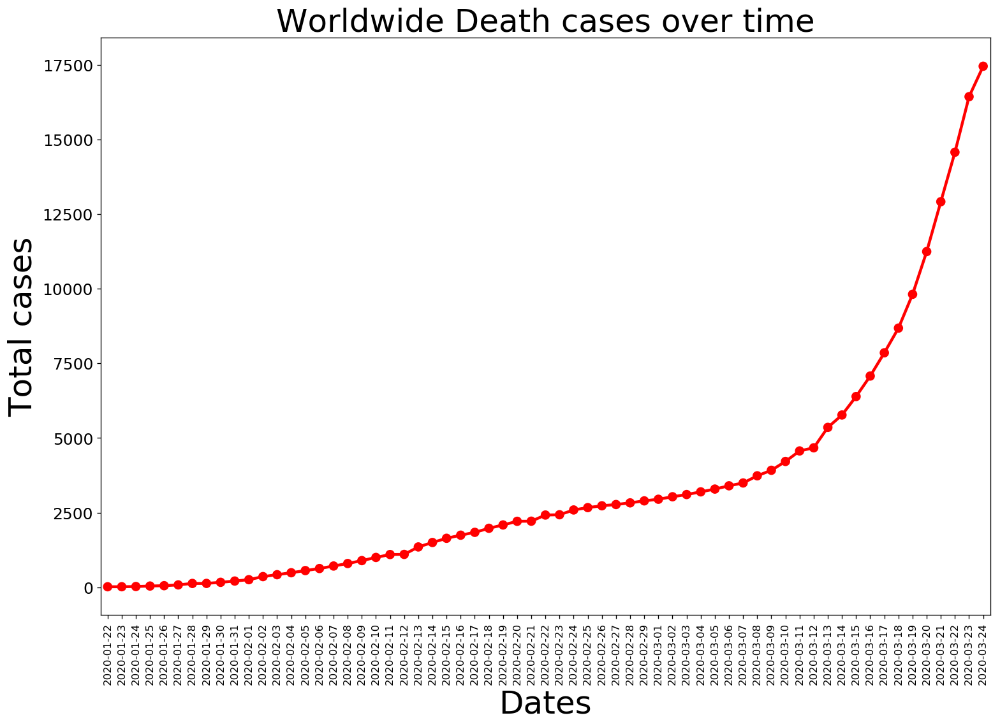

In [27]:
plt.figure(figsize= (15,10))
plt.xticks(rotation = 90 ,fontsize = 10)
plt.yticks(fontsize = 15)
plt.xlabel("Dates",fontsize = 30)
plt.ylabel('Total cases',fontsize = 30)
plt.title("Worldwide Death cases over time" , fontsize = 30)
total_cases = train_df.groupby('Date')['Date', 'Fatalities'].sum().reset_index()
total_cases['date'] = pd.to_datetime(total_cases['Date'])


ax = sns.pointplot( x = total_cases.date.dt.date ,y = total_cases.Fatalities , color = 'r')
ax.set(xlabel='Dates', ylabel='Total cases')

In [28]:
Confirmed_Country_Count = Confirmed_Cases_df.sort_values(by = 'Confirmed_Cases', ascending=False)[['Country','Confirmed_Cases']].head(10)

[Text(0, 0.5, 'Country'), Text(0.5, 0, 'Total cases')]

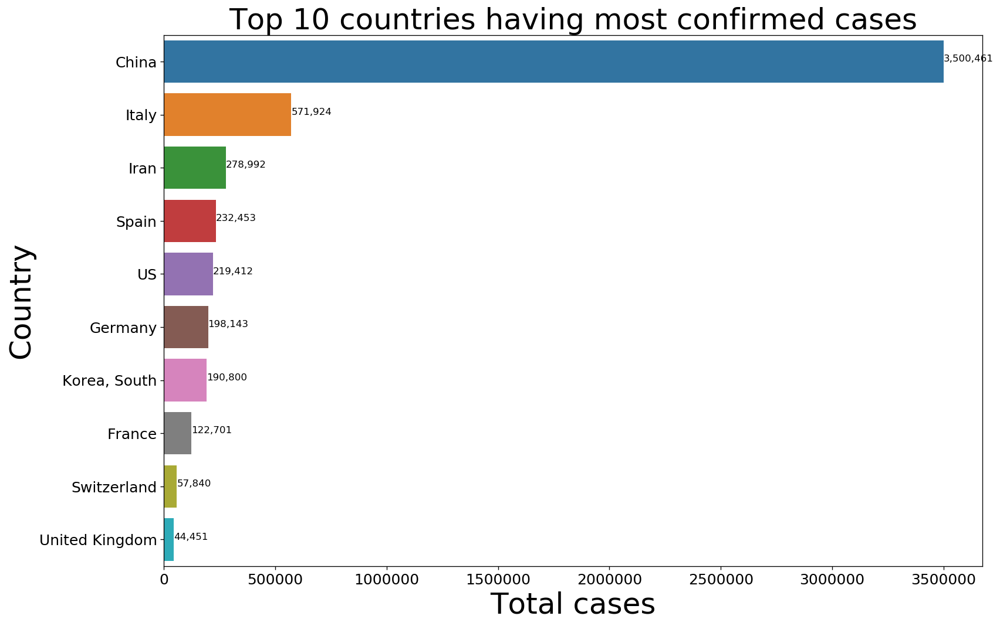

In [29]:
plt.figure(figsize= (15,10))
plt.xticks(fontsize = 15)
plt.yticks(fontsize = 15)
plt.xlabel("Total cases",fontsize = 30)
plt.ylabel('Country',fontsize = 30)
plt.title("Top 10 countries having most confirmed cases" , fontsize = 30)
ax = sns.barplot(x = Confirmed_Country_Count.Confirmed_Cases, y = Confirmed_Country_Count.Country)
for i, (value, name) in enumerate(zip(Confirmed_Country_Count.Confirmed_Cases,Confirmed_Country_Count.Country)):
    ax.text(value, i-.05, f'{value:,.0f}',  size=10, ha='left',  va='center')
ax.set(xlabel='Total cases', ylabel='Country')

# **Predictions**

Preliminaries to be done before fitting data

In [30]:
test_Unique_countries = list(temp_test_df['Country/Region'].unique())

In [31]:
def TrainConvertCountryToNum(country):
    index = Unique_countries.index(country)
    return index

def TestConvertCountryToNum(country):
    index = test_Unique_countries.index(country)
    return index

In [32]:
temp_train_df['Date'] = temp_train_df["Date"].apply(lambda x: x.replace("-",""))
temp_test_df['Date'] = temp_test_df["Date"].apply(lambda x: x.replace("-",""))

In [33]:
temp_train_df["Country/Region"] = temp_train_df["Country/Region"].apply(lambda x: TrainConvertCountryToNum(x))
temp_test_df["Country/Region"] = temp_test_df["Country/Region"].apply(lambda x: TestConvertCountryToNum(x))

In [34]:
x_train = temp_train_df[['Country/Region', 'Lat', 'Long', 'Date']]
y_train = temp_train_df['ConfirmedCases']

In [35]:
x_test = temp_test_df[['Country/Region', 'Lat', 'Long', 'Date']]

# **Confirmed Cases Prediction**

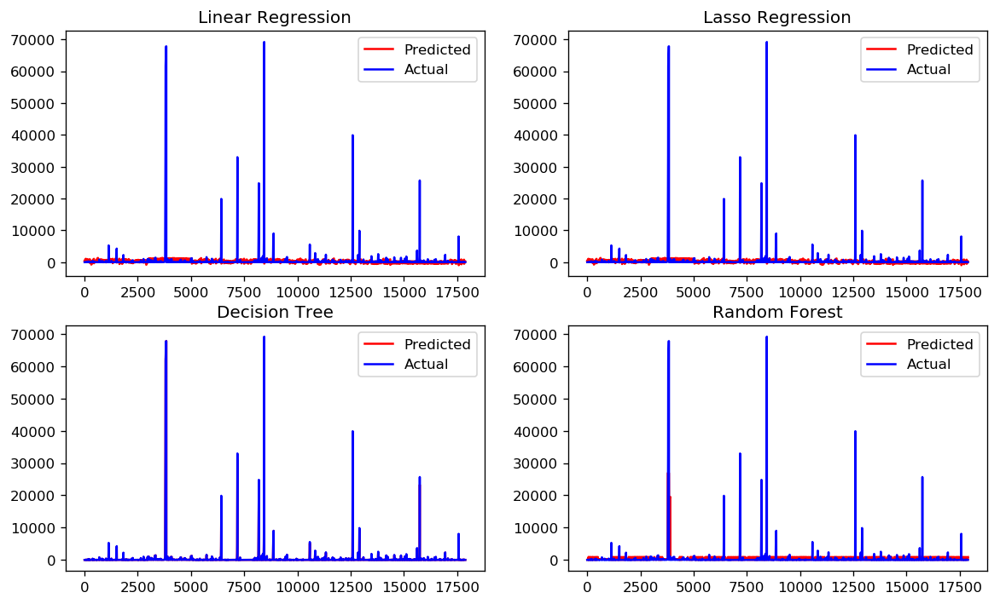

In [36]:
fig,axes= plt.subplots(nrows=2, ncols=2)
plt.subplots_adjust(left=4, right=5)
plt.rcParams.update({'figure.figsize':(9,7), 'figure.dpi':120})

# Linear Regression
lm = linear_model.LinearRegression()
lm.fit(x_train,y_train)
lm_y_pred = lm.predict(x_train)

# Lasso Regression
lm = linear_model.Lasso(alpha = 0.01, max_iter=10e5)
lm.fit(x_train,y_train)
lasso_y_pred = lm.predict(x_train)

# Decsion Tree
dtr = DTR()
dtr.fit(x_train,y_train)
DT_y_pred = dtr.predict(x_train)

# Random Forest
RF = RandomForestRegressor(max_depth=2, random_state=0)
RF.fit(x_train, y_train)
RF_y_pred = RF.predict(x_train)

axes[0][0].plot(lm_y_pred, color='red', label='Predicted')
axes[0][0].plot(y_train, color='blue', label = 'Actual')
axes[0][0].set_title("Linear Regression")
axes[0][0].legend()

axes[0][1].plot(lasso_y_pred, color='red', label='Predicted')
axes[0][1].plot(y_train, color='blue', label = 'Actual')
axes[0][1].set_title("Lasso Regression")
axes[0][1].legend()

axes[1][0].plot(DT_y_pred, color='red', label='Predicted')
axes[1][0].plot(y_train, color='blue', label = 'Actual')
axes[1][0].set_title("Decision Tree")
axes[1][0].legend()

axes[1][1].plot(RF_y_pred, color='red', label='Predicted')
axes[1][1].plot(y_train, color='blue', label = 'Actual')
axes[1][1].set_title("Random Forest")
plt.legend()

plt.show()

Predicting Confirmed cases for test data

In [37]:
dtr = DTR()
dtr.fit(x_train,y_train)
y_pred = dtr.predict(x_test)

In [38]:
test_df['ConfirmedCases'] = y_pred

[Text(0, 0.5, 'Total cases'), Text(0.5, 0, 'Dates')]

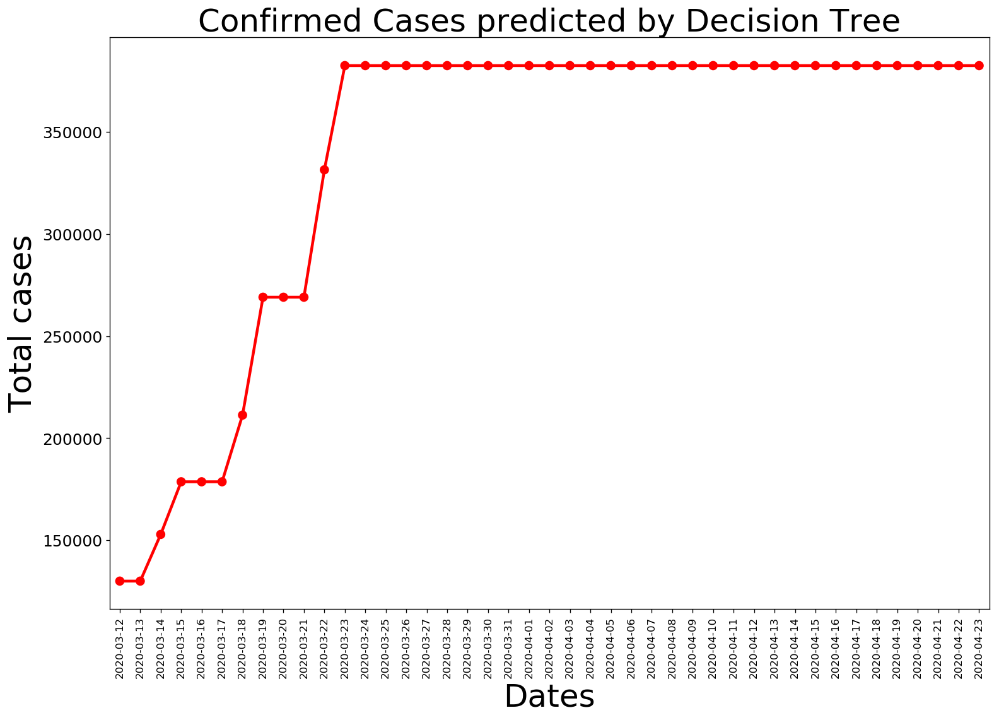

In [39]:
plt.figure(figsize= (15,10))
plt.xticks(rotation = 90 ,fontsize = 10)
plt.yticks(fontsize = 15)
plt.xlabel("Dates",fontsize = 30)
plt.ylabel('Total cases',fontsize = 30)
plt.title("Confirmed Cases predicted by Decision Tree" , fontsize = 30)
total_cases = test_df.groupby('Date')['Date', 'ConfirmedCases'].sum().reset_index()
total_cases['date'] = pd.to_datetime(total_cases['Date'])


ax = sns.pointplot( x = total_cases.date.dt.date ,y = total_cases.ConfirmedCases , color = 'r')
ax.set(xlabel='Dates', ylabel='Total cases')

Predicting Confirmed Cases using Random Forest

In [40]:
RF.fit(x_train, y_train)
y_pred = RF.predict(x_test)

In [41]:
test_df['ConfirmedCases'] = y_pred

[Text(0, 0.5, 'Total cases'), Text(0.5, 0, 'Dates')]

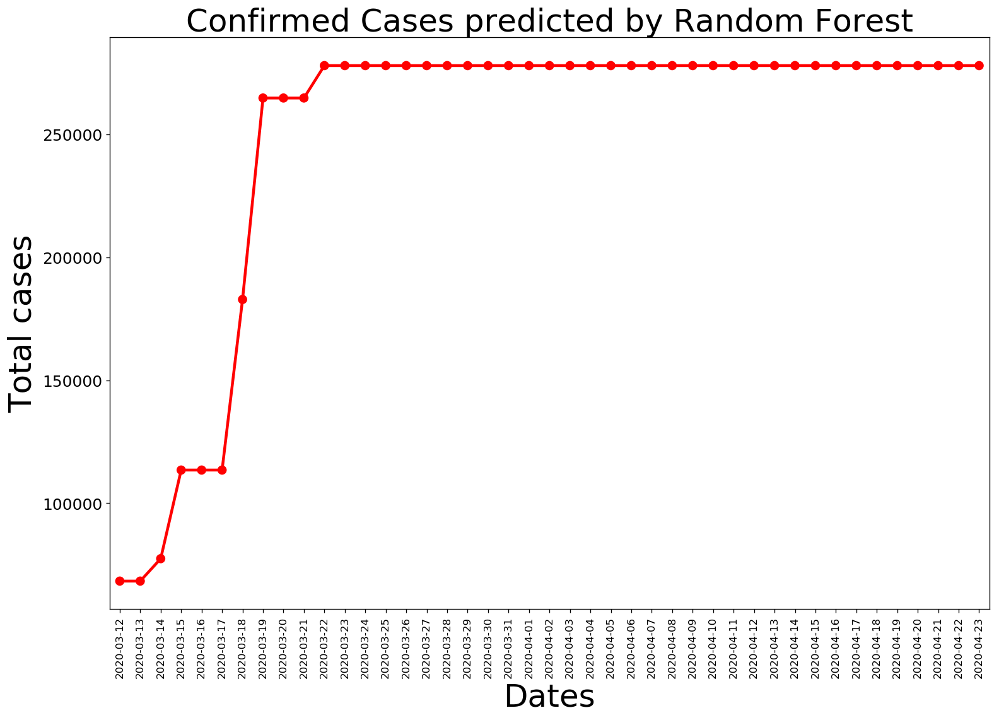

In [42]:
plt.figure(figsize= (15,10))
plt.xticks(rotation = 90 ,fontsize = 10)
plt.yticks(fontsize = 15)
plt.xlabel("Dates",fontsize = 30)
plt.ylabel('Total cases',fontsize = 30)
plt.title("Confirmed Cases predicted by Random Forest" , fontsize = 30)
total_cases = test_df.groupby('Date')['Date', 'ConfirmedCases'].sum().reset_index()
total_cases['date'] = pd.to_datetime(total_cases['Date'])


ax = sns.pointplot( x = total_cases.date.dt.date ,y = total_cases.ConfirmedCases , color = 'r')
ax.set(xlabel='Dates', ylabel='Total cases')

# **Death Cases**

In [43]:
y_train = temp_train_df['Fatalities']

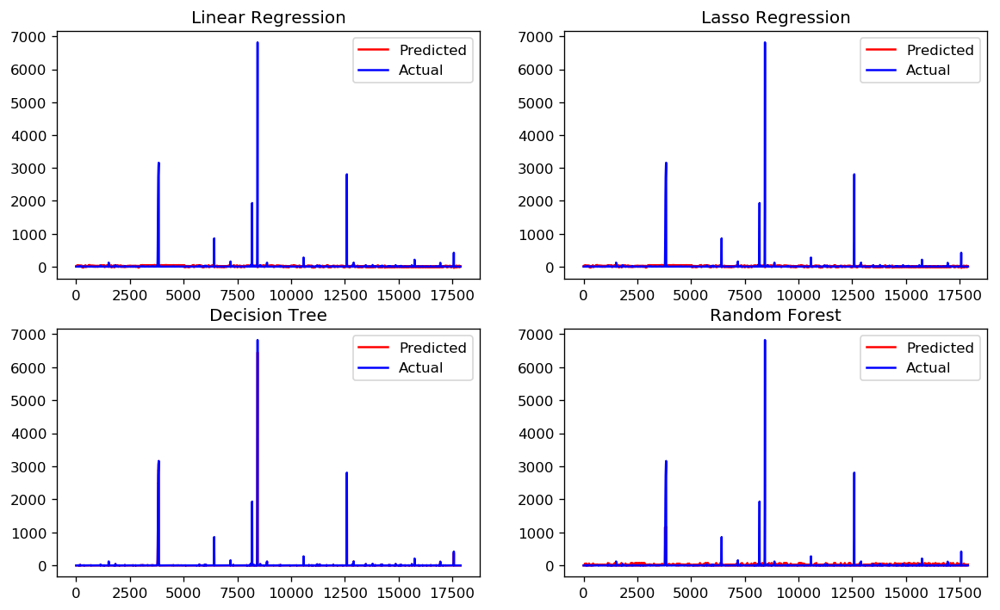

In [44]:
fig,axes= plt.subplots(nrows=2, ncols=2)
plt.subplots_adjust(left=4, right=5)
plt.rcParams.update({'figure.figsize':(9,7), 'figure.dpi':120})

# Linear Regression
lm = linear_model.LinearRegression()
lm.fit(x_train,y_train)
lm_y_pred = lm.predict(x_train)

# Lasso Regression
lm = linear_model.Lasso(alpha = 0.01, max_iter=10e5)
lm.fit(x_train,y_train)
lasso_y_pred = lm.predict(x_train)

# Decsion Tree
dtr = DTR()
dtr.fit(x_train,y_train)
DT_y_pred = dtr.predict(x_train)


# Random Forest
RF = RandomForestRegressor(max_depth=2, random_state=0)
RF.fit(x_train, y_train)
RF_y_pred = RF.predict(x_train)

axes[0][0].plot(lm_y_pred, color='red', label='Predicted')
axes[0][0].plot(y_train, color='blue', label = 'Actual')
axes[0][0].set_title("Linear Regression")
axes[0][0].legend()

axes[0][1].plot(lasso_y_pred, color='red', label='Predicted')
axes[0][1].plot(y_train, color='blue', label = 'Actual')
axes[0][1].set_title("Lasso Regression")
axes[0][1].legend()

axes[1][0].plot(DT_y_pred, color='red', label='Predicted')
axes[1][0].plot(y_train, color='blue', label = 'Actual')
axes[1][0].set_title("Decision Tree")
axes[1][0].legend()

axes[1][1].plot(RF_y_pred, color='red', label='Predicted')
axes[1][1].plot(y_train, color='blue', label = 'Actual')
axes[1][1].set_title("Random Forest")
plt.legend()

plt.show()

In [45]:
# Decision Tree predicts well 
dtr = DTR()
dtr.fit(x_train,y_train)
DT_y_pred = dtr.predict(x_test)

In [46]:
test_df['Death'] = DT_y_pred

[Text(0, 0.5, 'Total cases'), Text(0.5, 0, 'Dates')]

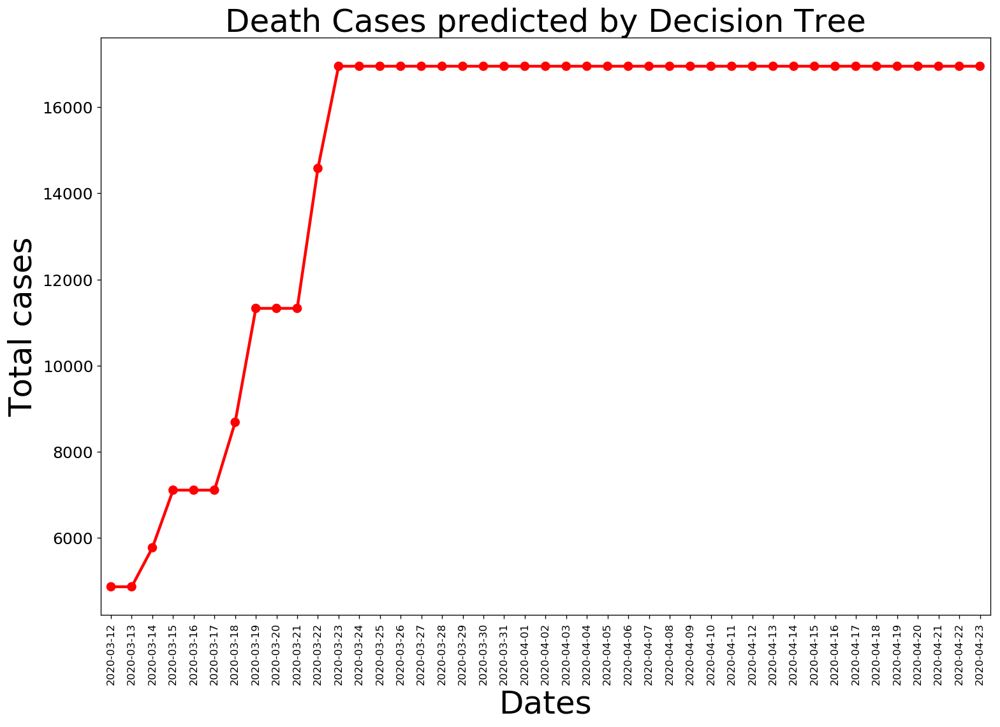

In [47]:
plt.figure(figsize= (15,10))
plt.xticks(rotation = 90 ,fontsize = 10)
plt.yticks(fontsize = 15)
plt.xlabel("Dates",fontsize = 30)
plt.ylabel('Total cases',fontsize = 30)
plt.title("Death Cases predicted by Decision Tree" , fontsize = 30)
total_cases = test_df.groupby('Date')['Date', 'Death'].sum().reset_index()
total_cases['date'] = pd.to_datetime(total_cases['Date'])


ax = sns.pointplot( x = total_cases.date.dt.date ,y = total_cases.Death , color = 'r')
ax.set(xlabel='Dates', ylabel='Total cases')

In [48]:
import folium

In [49]:
lattitude = list(train_df['Lat'].values)
longitude = list(train_df['Long'].values)

In [50]:
m = folium.Map([44.4604788, -110.8281375], zoom_start=11)

In [51]:
for i in range(len(lattitude)):
    folium.CircleMarker([lattitude[i], longitude[i]],
                            radius=15,
                            popup='country',
                            fill_color="#3db7e4", # divvy color
                           ).add_to(m)

In [52]:
m